# House Price Prediction Assignment

__Objective__ 
- Build a regression model using regularization to predict the actual value of the prospective properties.
- Determine the optimal value of lambda for ridge and lasso regression

In [1]:
# Supress Warnings

import warnings
warnings.filterwarnings('ignore')

# 1. Reading and Inspecting Data

In [2]:
# Importing libraries
import numpy as np
import pandas as pd

# Importing libraries for Visualisation
import matplotlib.pyplot as plt
import seaborn as sns

# Importing libraries for Model building
from sklearn import linear_model
from sklearn.linear_model import LinearRegression

# Importing libraries for Cross validation and regularization model building
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV

#### Reading data

In [3]:
# Reading data from dataset
house_price = pd.read_csv("C:/PGDDS/Machine_learning/Predictive_Analytics_II/Assignment_Advanced_Regression/train.csv")
house_price.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


#### Inspecting data

In [4]:
house_price.shape

(1460, 81)

In [5]:
house_price.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
Id               1460 non-null int64
MSSubClass       1460 non-null int64
MSZoning         1460 non-null object
LotFrontage      1201 non-null float64
LotArea          1460 non-null int64
Street           1460 non-null object
Alley            91 non-null object
LotShape         1460 non-null object
LandContour      1460 non-null object
Utilities        1460 non-null object
LotConfig        1460 non-null object
LandSlope        1460 non-null object
Neighborhood     1460 non-null object
Condition1       1460 non-null object
Condition2       1460 non-null object
BldgType         1460 non-null object
HouseStyle       1460 non-null object
OverallQual      1460 non-null int64
OverallCond      1460 non-null int64
YearBuilt        1460 non-null int64
YearRemodAdd     1460 non-null int64
RoofStyle        1460 non-null object
RoofMatl         1460 non-null object
Exterior1st      1460 non-n

In [6]:
house_price.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,...,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,...,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,...,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,...,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,...,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,...,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


#### Visualising the data

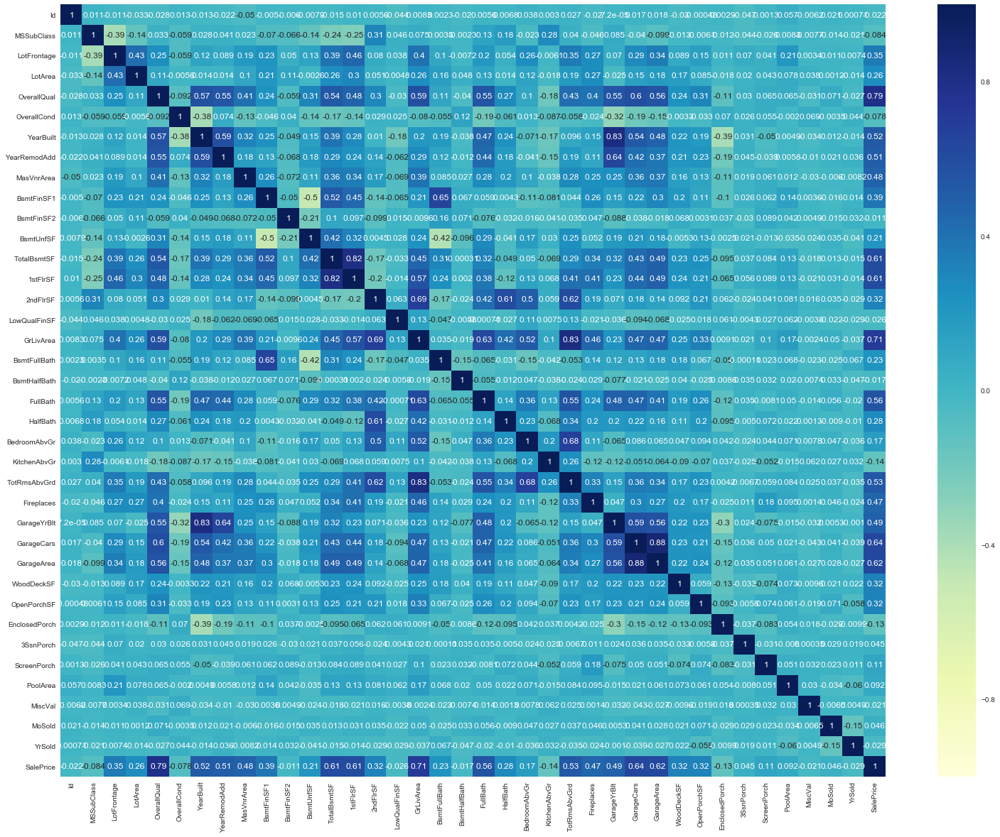

In [7]:
# Heatmap for numerical variables
plt.figure(figsize=(26,20))
sns.heatmap(house_price.corr(), cmap='YlGnBu', annot=True)
plt.show()

We can observe that target variable __SalePrice__ is correlated with many features such as :-
- OverallQual (Rates the overall material and finish of the house)
- GrLivArea (Above grade (ground) living area square feet)
- GarageCars (Size of garage in car capacity)
- GarageArea (Size of garage in square feet)
- TotalBsmtSF (Total square feet of basement area)
- 1stFlrSF (First Floor square feet)
<br>
And more...

# 2. Data Cleaning

#### Checking duplicate values

In [8]:
# To verify if any duplicate row is present or not
house_price.duplicated(subset=['Id']).sum()

0

We observed that there are <span style="color:green">__no duplicate values__</span> present.

#### Checking Null values

In [9]:
round(100*(house_price.isnull().sum()/len(house_price.index)),2)

Id                0.00
MSSubClass        0.00
MSZoning          0.00
LotFrontage      17.74
LotArea           0.00
Street            0.00
Alley            93.77
LotShape          0.00
LandContour       0.00
Utilities         0.00
LotConfig         0.00
LandSlope         0.00
Neighborhood      0.00
Condition1        0.00
Condition2        0.00
BldgType          0.00
HouseStyle        0.00
OverallQual       0.00
OverallCond       0.00
YearBuilt         0.00
YearRemodAdd      0.00
RoofStyle         0.00
RoofMatl          0.00
Exterior1st       0.00
Exterior2nd       0.00
MasVnrType        0.55
MasVnrArea        0.55
ExterQual         0.00
ExterCond         0.00
Foundation        0.00
                 ...  
BedroomAbvGr      0.00
KitchenAbvGr      0.00
KitchenQual       0.00
TotRmsAbvGrd      0.00
Functional        0.00
Fireplaces        0.00
FireplaceQu      47.26
GarageType        5.55
GarageYrBlt       5.55
GarageFinish      5.55
GarageCars        0.00
GarageArea        0.00
GarageQual 

#### <span style="color:blue">__Observation from Data Dictionary__</span>
- There are some columns having NA has actual Null values.
- There are some columns having NA value but from Data-dictionary they are not Null values, they have some specific meaning. 

### Data cleaning and data quality issues handling

#### <span style="color:blue">Inspecting data having some NA values</span>

In [10]:
# Inspecting data having NA values
na_df = round(100*(house_price.isnull().sum()/len(house_price.index)),2)
print(na_df[na_df > 0.00].sort_values(ascending=False))

PoolQC          99.52
MiscFeature     96.30
Alley           93.77
Fence           80.75
FireplaceQu     47.26
LotFrontage     17.74
GarageYrBlt      5.55
GarageType       5.55
GarageFinish     5.55
GarageQual       5.55
GarageCond       5.55
BsmtFinType2     2.60
BsmtExposure     2.60
BsmtFinType1     2.53
BsmtCond         2.53
BsmtQual         2.53
MasVnrArea       0.55
MasVnrType       0.55
Electrical       0.07
dtype: float64


##### <span style="color:blue">From the data dictionary we observe that NA values in following columns has specific meaning</span>
- Alley - No alley access
- BsmtQual - No Basement
- BsmtCond - No Basement
- BsmtExposure - No Basement
- BsmtFinType1 - No Basement
- BsmtFinType2 - No Basement
- FireplaceQu - No Fireplace
- GarageType - No Garage
- GarageFinish - No Garage
- GarageQual - No Garage
- GarageCond - No Garage
- PoolQC - No Pool
- Fence - No Fence
- MiscFeature - None


##### <span style="color:red">Replacing NaN with values as follows</span>
- Alley - No_Alley_Access
- BsmtQual, BsmtCond, BsmtExposure, BsmtFinType1, BsmtFinType2 - No_Basement
- FireplaceQu - No_Fireplace
- GarageType, GarageFinish, GarageQual, GarageCond - No_Garage
- PoolQC - No_Pool
- Fence - No_Fence
- MiscFeature - None

In [11]:
# Replacing NaN with No_Alley_Access for 1 column
house_price['Alley'] = house_price['Alley'].fillna('No_Alley_Access')

# Replacing NaN with No_Basement for 5 columns
col1 = ['BsmtQual','BsmtCond','BsmtExposure','BsmtFinType1','BsmtFinType2']
house_price[col1] = house_price[col1].fillna('No_Basement')

# Replacing NaN with No_Fireplace for 1 column
house_price['FireplaceQu'] = house_price['FireplaceQu'].fillna('No_Fireplace')

# Replacing NaN with No_Garage for 4 columns
col2 = ['GarageType','GarageFinish','GarageQual','GarageCond']
house_price[col2] = house_price[col2].fillna('No_Garage')

# Replacing NaN with No_Pool for 1 column
house_price['PoolQC'] = house_price['PoolQC'].fillna('No_Pool')

# Replacing NaN with No_Fence for 1 column
house_price['Fence'] = house_price['Fence'].fillna('No_Fence')

# Replacing NaN with No_Fireplace for 1 column
house_price['MiscFeature'] = house_price['MiscFeature'].fillna('None')

In [12]:
# Again Inspecting data having NA values
na_df = round(100*(house_price.isnull().sum()/len(house_price.index)),2)
print(na_df[na_df > 0.00].sort_values(ascending=False))

LotFrontage    17.74
GarageYrBlt     5.55
MasVnrArea      0.55
MasVnrType      0.55
Electrical      0.07
dtype: float64


##### <span style="color:blue">From the data dictionary we observe that NA values in following columns are actual Null values</span>
- LotFrontage - Has 17.74% Null values
- MasVnrType - Has 0.55% Null values
- MasVnrArea - Has 0.55% Null values
- Electrical - Has 0.07% Null values
- GarageYrBlt - Has 5.55% Null values

So removing Null from the columns having less than 10% Null values 

##### <span style="color:red">Removing Null values from the columns having less than 10% Null values</span>

In [13]:
# Dropping less than 10% Null values
house_price.dropna(subset = ['MasVnrType','MasVnrArea','Electrical','GarageYrBlt'], inplace=True)

In [14]:
# Again Inspecting data having NA values
na_df = round(100*(house_price.isnull().sum()/len(house_price.index)),2)
print(na_df[na_df > 0.00])

LotFrontage    18.25
dtype: float64


##### <span style="color:blue">Assumption for LotFrontage column</span>
We can observe that 'LotFrontage' column has around 18% of actual Null values. 
We can follow any of the three steps to handle these null values
1. Drop rows having Null values
2. Impute these null values with either mean/median/mode
3. Drop column altogether

Drawbacks of 1st and 3rd step
1. Dataset is small contains only 1460 datapoints, and removing these many data is not feasible.
3. Null values are not that high i.e. it is 18%, and also LotFrontage columns seems important for analysis.

So selecting 2nd step and <span style="color:red">__Imputing null values in LotFrontage column with median value__</span>

In [15]:
house_price['LotFrontage'] = house_price['LotFrontage'].fillna(house_price['LotFrontage'].median())

In [16]:
# Again Inspecting data having NA values
print(round(100*(house_price.isnull().sum()/len(house_price.index)),2))
print("\n")

# Checking is there any NaN value present in any column
print(na_df[na_df > 0.00])

Id               0.0
MSSubClass       0.0
MSZoning         0.0
LotFrontage      0.0
LotArea          0.0
Street           0.0
Alley            0.0
LotShape         0.0
LandContour      0.0
Utilities        0.0
LotConfig        0.0
LandSlope        0.0
Neighborhood     0.0
Condition1       0.0
Condition2       0.0
BldgType         0.0
HouseStyle       0.0
OverallQual      0.0
OverallCond      0.0
YearBuilt        0.0
YearRemodAdd     0.0
RoofStyle        0.0
RoofMatl         0.0
Exterior1st      0.0
Exterior2nd      0.0
MasVnrType       0.0
MasVnrArea       0.0
ExterQual        0.0
ExterCond        0.0
Foundation       0.0
                ... 
BedroomAbvGr     0.0
KitchenAbvGr     0.0
KitchenQual      0.0
TotRmsAbvGrd     0.0
Functional       0.0
Fireplaces       0.0
FireplaceQu      0.0
GarageType       0.0
GarageYrBlt      0.0
GarageFinish     0.0
GarageCars       0.0
GarageArea       0.0
GarageQual       0.0
GarageCond       0.0
PavedDrive       0.0
WoodDeckSF       0.0
OpenPorchSF  

<span style="color:green">__No columns has Null values anymore__</span>

In [17]:
house_price.shape

(1370, 81)

#### Rows having more than 5 Nan values

In [18]:
# Are there any rows having more than 5 Nan values ?
house_price[house_price.isnull().sum(axis=1) >=5]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice


### Data Preparation

#### <span style="color:blue"> Observing numerical columns</span>
Some numerical variables in data dictionary are actually categorical variables. Those are:
- MSSubClass
- OverallQual
- OverallCond

In [19]:
print('MSSubClass datatype:',house_price['MSSubClass'].dtypes)
print('OverallQual datatype:',house_price['OverallQual'].dtypes)
print('OverallCond datatype:',house_price['OverallCond'].dtypes)

MSSubClass datatype: int64
OverallQual datatype: int64
OverallCond datatype: int64


##### <span style="color:red">Converting data types of these columns into category</span>

In [20]:
house_price['MSSubClass'] = house_price['MSSubClass'].astype('category')
house_price['OverallQual'] = house_price['OverallQual'].astype('category')
house_price['OverallCond'] = house_price['OverallCond'].astype('category')

#### Inspecting columns having only single value

In [21]:
# Inspecting whether any column has only 1 value
house_price.loc[:,(house_price.nunique()==1)].head(5)

""
0
1
2
3
4


#### Inspecting columns having 2 values

In [22]:
# Inspecting whether any column has only 2 value
house_price.loc[:,(house_price.nunique()==2)].head()

,Street,Utilities,CentralAir
0,Pave,AllPub,Y
1,Pave,AllPub,Y
2,Pave,AllPub,Y
3,Pave,AllPub,Y
4,Pave,AllPub,Y


##### Street column

In [23]:
# Street column
house_price['Street'].value_counts()

Pave    1365
Grvl       5
Name: Street, dtype: int64

This column has __99.6% values as Pave__

##### Utilities column

In [24]:
# Street column
house_price['Utilities'].value_counts()

AllPub    1369
NoSeWa       1
Name: Utilities, dtype: int64

This column has __99.92% values as Pave__

##### CentralAir column

In [25]:
# CentralAir column
house_price['CentralAir'].value_counts()

Y    1301
N      69
Name: CentralAir, dtype: int64

In [26]:
# Dropping column having predominantly single value
house_price.drop(['Street','Utilities'], axis=1, inplace=True)

#### Removing Id column

In [27]:
house_price.drop(['Id'], axis=1, inplace=True)

In [28]:
house_price.shape

(1370, 78)

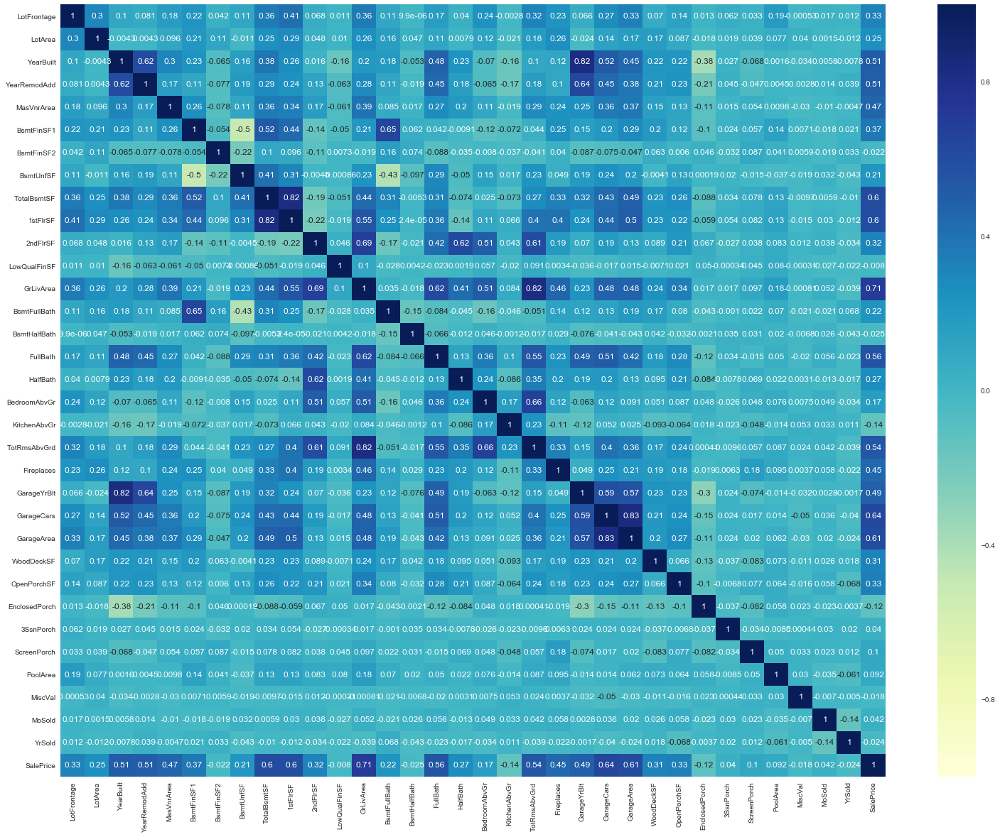

In [29]:
# Heatmap for numerical variables
plt.figure(figsize=(26,20))
sns.heatmap(house_price.corr(), cmap='YlGnBu', annot=True)
plt.show()

# 3. Dummy Variable Creation

#### Dummy variables for binary variables (Yes/No) to 0/1

In [30]:
# Creating dummy variables
house_price['CentralAir'] = house_price['CentralAir'].map({'Y': 1, 'N': 0})

#### Dummy variables for Categorical variable having more than 3 levels

In [31]:
# Creating dummy variables for categorical variables with more than 2 values
house_price = pd.get_dummies(house_price, drop_first=True)

# Inspecting dataframe with all variables including dummy
house_price.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,CentralAir,...,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,65.0,8450,2003,2003,196.0,706,0,150,856,1,...,0,0,0,0,1,0,0,0,1,0
1,80.0,9600,1976,1976,0.0,978,0,284,1262,1,...,0,0,0,0,1,0,0,0,1,0
2,68.0,11250,2001,2002,162.0,486,0,434,920,1,...,0,0,0,0,1,0,0,0,1,0
3,60.0,9550,1915,1970,0.0,216,0,540,756,1,...,0,0,0,0,1,0,0,0,0,0
4,84.0,14260,2000,2000,350.0,655,0,490,1145,1,...,0,0,0,0,1,0,0,0,1,0


# 4. Outlier treatment

In [32]:
# Selecting columns having only numerical values except Year columns
house_price_col = house_price[['LotFrontage','LotArea','MasVnrArea','BsmtFinSF1','BsmtUnfSF','TotalBsmtSF','1stFlrSF',
                               '2ndFlrSF','LowQualFinSF','GrLivArea','GarageArea','WoodDeckSF','OpenPorchSF','EnclosedPorch',
                               'MiscVal']]

In [33]:
house_price_col.describe(percentiles=[.25,.5,.75,.90,.95,.99])

,LotFrontage,LotArea,MasVnrArea,BsmtFinSF1,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,MiscVal
count,1370.000000,1370.000000,1370.000000,1370.000000,1370.000000,1370.000000,1370.000000,1370.000000,1370.000000,1370.000000,1370.000000,1370.000000,1370.000000,1370.000000,1370.000000
mean,70.542336,10687.435036,109.076642,454.211679,570.742336,1073.372263,1176.086131,353.202190,4.162044,1533.450365,500.462774,97.656204,47.028467,21.031387,43.170803
std,21.950673,10228.507006,184.589326,458.985739,444.050989,435.558797,385.381717,439.497524,40.260837,519.489200,185.988074,126.805998,64.995049,60.519492,503.247977
min,21.000000,1300.000000,0.000000,0.000000,0.000000,0.000000,438.000000,0.000000,0.000000,438.000000,160.000000,0.000000,0.000000,0.000000,0.000000
25%,60.000000,7731.000000,0.000000,0.000000,225.500000,808.500000,894.000000,0.000000,0.000000,1152.000000,377.500000,0.000000,0.000000,0.000000,0.000000
50%,70.000000,9591.000000,0.000000,399.500000,477.500000,1008.000000,1098.000000,0.000000,0.000000,1479.000000,484.000000,0.000000,27.000000,0.000000,0.000000
75%,79.000000,11712.750000,171.750000,728.000000,811.000000,1314.000000,1414.000000,737.000000,0.000000,1788.000000,582.750000,171.000000,69.000000,0.000000,0.000000
90%,92.000000,14573.300000,340.000000,1074.400000,1237.300000,1614.200000,1686.100000,975.000000,0.000000,2169.300000,770.200000,264.000000,130.000000,108.000000,0.000000
95%,104.000000,17501.650000,461.750000,1275.650000,1475.500000,1753.000000,1837.100000,1146.950000,0.000000,2470.750000,856.550000,341.100000,171.100000,180.000000,0.000000
99%,134.930000,39410.900000,802.200000,1583.230000,1796.550000,2175.980000,2218.860000,1417.720000,127.440000,3120.680000,1015.860000,509.620000,282.930000,260.550000,700.000000


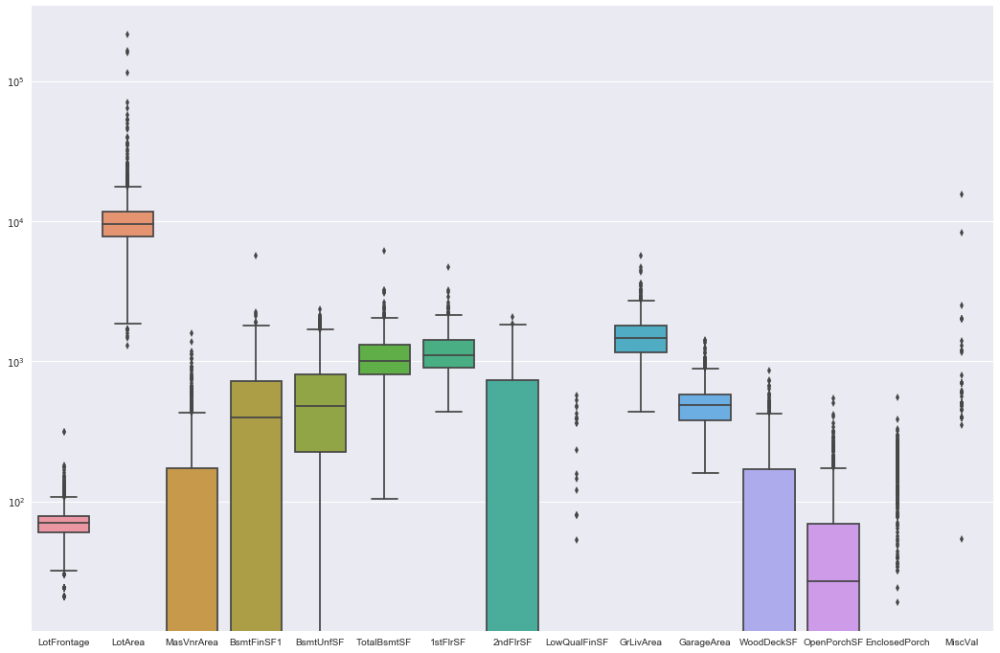

In [34]:
# Plotting Box plot to check outlier
plt.figure(figsize = (18,12))
ax = sns.boxplot(x = house_price_col , orient='v')
ax.set_yscale('log') # Using log scale
plt.show()

We can observe that <span style="color:green">__there are outliers in the data__</span>

#### Removing outlier

In [35]:
# Getting 99% quantile for outlier treatment

# LotFrontage column
LotFrontage = house_price["LotFrontage"].quantile(.99)

# LotArea column
LotArea = house_price["LotArea"].quantile(.99)

# MasVnrArea column
MasVnrArea = house_price["MasVnrArea"].quantile(.99)

# BsmtFinSF1 column
BsmtFinSF1 = house_price["BsmtFinSF1"].quantile(.99)

# BsmtUnfSF column
BsmtUnfSF = house_price["BsmtUnfSF"].quantile(.99)

# TotalBsmtSF column
TotalBsmtSF = house_price["TotalBsmtSF"].quantile(.99)

# 1stFlrSF column
FirstFlrSF = house_price["1stFlrSF"].quantile(.99)

# 2ndFlrSF column
SecondFlrSF = house_price["2ndFlrSF"].quantile(.99)

# LowQualFinSF column
LowQualFinSF = house_price["LowQualFinSF"].quantile(.99)

# GrLivArea column
GrLivArea = house_price["GrLivArea"].quantile(.99)

# GarageArea column
GarageArea = house_price["GarageArea"].quantile(.99)

# WoodDeckSF column
WoodDeckSF = house_price["WoodDeckSF"].quantile(.99)

# OpenPorchSF column
OpenPorchSF = house_price["OpenPorchSF"].quantile(.99)

# EnclosedPorch column
EnclosedPorch = house_price["EnclosedPorch"].quantile(.99)

# MiscVal column
MiscVal = house_price["MiscVal"].quantile(.99)

In [36]:
house_price = house_price.loc[(house_price["LotFrontage"] <= LotFrontage) & (house_price["LotArea"] <= LotArea) & 
                              (house_price["MasVnrArea"] <= MasVnrArea) & (house_price["BsmtFinSF1"] <= BsmtFinSF1) &
                              (house_price["BsmtUnfSF"] <= BsmtUnfSF) & (house_price["TotalBsmtSF"] <= TotalBsmtSF) & 
                              (house_price["1stFlrSF"] <= FirstFlrSF) & (house_price["2ndFlrSF"] <= SecondFlrSF) & 
                              (house_price["LowQualFinSF"] <= LowQualFinSF) & (house_price["GrLivArea"] <= GrLivArea) &
                              (house_price["GarageArea"] <= GarageArea) & (house_price["WoodDeckSF"] <= WoodDeckSF) & 
                              (house_price["OpenPorchSF"] <= OpenPorchSF) &  (house_price["EnclosedPorch"] <= EnclosedPorch) &
                              (house_price["MiscVal"] <= MiscVal)]

In [37]:
house_price.shape

(1229, 278)

#### <span style="color:green">After all Data cleaning and Data preparation we have 1229 datapoints out of 1460 i.e. around 84% data is available for analysis and prediction</span>

# 5. Test-Train Split

In [38]:
# Imprting train-test split
from sklearn.model_selection import train_test_split

In [39]:
# Putting feature variable to X
X = house_price.drop(['SalePrice'], axis=1)
X.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,CentralAir,...,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,65.0,8450,2003,2003,196.0,706,0,150,856,1,...,0,0,0,0,1,0,0,0,1,0
1,80.0,9600,1976,1976,0.0,978,0,284,1262,1,...,0,0,0,0,1,0,0,0,1,0
2,68.0,11250,2001,2002,162.0,486,0,434,920,1,...,0,0,0,0,1,0,0,0,1,0
4,84.0,14260,2000,2000,350.0,655,0,490,1145,1,...,0,0,0,0,1,0,0,0,1,0
5,85.0,14115,1993,1995,0.0,732,0,64,796,1,...,0,0,0,0,1,0,0,0,1,0


In [40]:
# Putting response variable to y
y = house_price['SalePrice']
y.head()

0    208500
1    181500
2    223500
4    250000
5    143000
Name: SalePrice, dtype: int64

In [41]:
# Splitting the data into train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, test_size=0.3, random_state=100)

# 6. Feature Scaling

In [42]:
# Importing libraries for Standardization
from sklearn.preprocessing import StandardScaler

In [43]:
X_train[['LotFrontage','LotArea','MasVnrArea','BsmtFinSF1','BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF',
         'GrLivArea','GarageArea','WoodDeckSF','OpenPorchSF','EnclosedPorch','MiscVal']]
X_train.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,CentralAir,...,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
1113,66.0,8923,1953,2006,0.0,643,0,365,1008,1,...,0,0,0,0,1,0,0,0,1,0
284,50.0,8012,1992,1992,0.0,430,0,1145,1575,1,...,0,0,0,0,1,0,0,0,1,0
722,70.0,8120,1970,1970,0.0,191,0,673,864,1,...,0,0,0,0,1,0,0,0,1,0
260,120.0,19296,1962,1962,399.0,672,690,0,1362,1,...,0,0,0,0,1,0,0,0,1,0
550,53.0,4043,1977,1977,0.0,559,0,510,1069,1,...,0,0,0,0,0,0,0,0,0,0


In [44]:
scaler = StandardScaler()

# Performing Standardization of columns which needs to be scaled on train data
X_train[['LotFrontage', 'LotArea','MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2',
        'BsmtUnfSF','TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 
        'GrLivArea','GarageArea', 'WoodDeckSF', 'OpenPorchSF','EnclosedPorch',
        '3SsnPorch','ScreenPorch', 'PoolArea',
        'MiscVal']] = scaler.fit_transform(X_train[['LotFrontage', 'LotArea','MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2',
                                                    'BsmtUnfSF','TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 
                                                    'GrLivArea','GarageArea', 'WoodDeckSF', 'OpenPorchSF','EnclosedPorch',
                                                    '3SsnPorch','ScreenPorch', 'PoolArea',
                                                    'MiscVal']])
X_train.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,CentralAir,...,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
1113,-0.136985,-0.147522,1953,2006,-0.637147,0.545541,-0.294568,-0.433571,-0.034202,1,...,0,0,0,0,1,0,0,0,1,0
284,-1.010033,-0.366496,1992,1992,-0.637147,0.015340,-0.294568,1.428160,1.512605,1,...,0,0,0,0,1,0,0,0,1,0
722,0.081277,-0.340536,1970,1970,-0.637147,-0.579580,-0.294568,0.301574,-0.427042,1,...,0,0,0,0,1,0,0,0,1,0
260,2.809554,2.345798,1962,1962,2.327778,0.617728,3.766507,-1.304766,0.931530,1,...,0,0,0,0,1,0,0,0,1,0
550,-0.846337,-1.320510,1977,1977,-0.637147,0.336448,-0.294568,-0.087480,0.132209,1,...,0,0,0,0,0,0,0,0,0,0


# 7. Observing Correlations

In [45]:
# Correlation matrix
corr = X_train.corr() 
cm = sns.light_palette("blue", as_cmap=True) 
corr.style.background_gradient(cmap=cm).set_precision(2)

In [46]:
# Selecting only columns having correlation more than 0.70
rows, cols = X_train.shape
col = list(X_train.columns)

corr = X_train.corr().values

for i in range(cols):
    for j in range(i+1, cols):
        if corr[i,j] > 0.80:
            print(col[i], ' ', col[j], ' ', corr[i,j])

YearBuilt   GarageYrBlt   0.847422573266
2ndFlrSF   HouseStyle_2Story   0.849288070646
GrLivArea   TotRmsAbvGrd   0.802310508986
GarageCars   GarageArea   0.823371664383
MiscVal   MiscFeature_Shed   0.930119056139
MSSubClass_45   HouseStyle_1.5Unf   0.925277891761
MSSubClass_75   HouseStyle_2.5Unf   0.816020628348
MSSubClass_80   HouseStyle_SLvl   0.948872578607
MSSubClass_85   HouseStyle_SFoyer   0.813111623465
MSSubClass_90   BldgType_Duplex   1.0
MSSubClass_190   BldgType_2fmCon   0.963055098258
MSZoning_FV   Neighborhood_Somerst   0.868060306245
Exterior1st_CBlock   Exterior2nd_CBlock   1.0
Exterior1st_CemntBd   Exterior2nd_CmentBd   0.983657167616
Exterior1st_HdBoard   Exterior2nd_HdBoard   0.855305479092
Exterior1st_MetalSd   Exterior2nd_MetalSd   0.981322106953
Exterior1st_VinylSd   Exterior2nd_VinylSd   0.97740831278
Exterior1st_Wd Sdng   Exterior2nd_Wd Sdng   0.877855885306
BsmtQual_No_Basement   BsmtCond_No_Basement   1.0
BsmtQual_No_Basement   BsmtExposure_No_Basement   0.97

In [47]:
X_train.drop(['HouseStyle_2Story','MiscFeature_Shed','MSSubClass_45','MSSubClass_75','MSSubClass_80','MSSubClass_85',
              'MSSubClass_90', 'MSSubClass_190','Neighborhood_Somerst','Exterior2nd_CBlock','Exterior2nd_CmentBd',
              'Exterior2nd_HdBoard','Exterior2nd_MetalSd', 'Exterior2nd_VinylSd','Exterior2nd_Wd Sdng','BsmtQual_No_Basement',
              'BsmtCond_No_Basement', 'Electrical_Mix', 'BsmtExposure_No_Basement','BsmtFinType2_No_Basement',
              'SaleCondition_Partial'], axis=1, inplace=True)

X_test.drop(['HouseStyle_2Story','MiscFeature_Shed','MSSubClass_45','MSSubClass_75','MSSubClass_80','MSSubClass_85',
              'MSSubClass_90', 'MSSubClass_190','Neighborhood_Somerst','Exterior2nd_CBlock','Exterior2nd_CmentBd',
              'Exterior2nd_HdBoard','Exterior2nd_MetalSd', 'Exterior2nd_VinylSd','Exterior2nd_Wd Sdng','BsmtQual_No_Basement',
              'BsmtCond_No_Basement', 'Electrical_Mix', 'BsmtExposure_No_Basement','BsmtFinType2_No_Basement',
              'SaleCondition_Partial'], axis=1, inplace=True)

In [48]:
# Inspecting dataframe before model building
X_train.shape

(860, 256)

# 8. Model Building and Prediction

In [49]:
# Import library to find out score (R2)
from sklearn import metrics
from sklearn.metrics import r2_score

#### Applying scaling to the columns in test data

In [50]:
# Performing Standardization of columns which needs to be scaled on test data
X_test[['LotFrontage', 'LotArea','MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2',
        'BsmtUnfSF','TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 
        'GrLivArea','GarageArea', 'WoodDeckSF', 'OpenPorchSF','EnclosedPorch',
        '3SsnPorch','ScreenPorch', 'PoolArea',
        'MiscVal']] = scaler.transform(X_test[['LotFrontage', 'LotArea','MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2',
                                                    'BsmtUnfSF','TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 
                                                    'GrLivArea','GarageArea', 'WoodDeckSF', 'OpenPorchSF','EnclosedPorch',
                                                    '3SsnPorch','ScreenPorch', 'PoolArea',
                                                    'MiscVal']])
X_test.head()

,LotFrontage,LotArea,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,CentralAir,...,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal
632,0.899760,0.568049,1977,1977,0.915909,0.991109,-0.294568,0.041409,0.997003,1,...,0,0,0,0,0,1,0,0,1,0
855,0.081277,-0.634504,1962,2010,-0.637147,0.585368,-0.294568,-0.395382,0.053096,1,...,0,0,0,0,0,1,0,0,0,1
631,-1.883082,-1.189029,2006,2006,0.165389,-0.995277,-0.294568,2.347091,1.455316,1,...,0,0,0,0,0,1,0,0,0,1
751,0.081277,-0.429472,2003,2003,-0.637147,-1.055018,-0.294568,0.270545,-0.983566,1,...,0,0,0,0,0,1,0,0,0,1
619,0.899760,0.650735,2003,2003,1.042234,1.113080,-0.294568,0.153590,1.258896,1,...,0,0,0,0,0,1,0,0,0,1


#### <span style="color:blue">Problem Statement Requirement</span>
Problem statement says that __build a regression model using regularization__

Method Used
- Lasso Regression - For feature selection
- Ridge Regression - For finding optimal alpha

## 8.1 Lasso Regression

In [51]:
# list of alphas to tune
params = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 4.0, 5.0, 
                    6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000 ]}

lasso = Lasso()

# cross validation
folds = 5 # selecting number of fold for cross validation

# Performing Grid Search Cross Validation using Lasso
lasso_cv = GridSearchCV(estimator = lasso, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error', 
                        cv = folds, return_train_score=True, verbose = 1)            

# Fitting on train data
lasso_cv.fit(X_train, y_train) 

Fitting 5 folds for each of 28 candidates, totalling 140 fits


[Parallel(n_jobs=1)]: Done 140 out of 140 | elapsed:   19.4s finished


GridSearchCV(cv=5, error_score='raise',
       estimator=Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False),
       fit_params={}, iid=True, n_jobs=1,
       param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score=True,
       scoring='neg_mean_absolute_error', verbose=1)

In [52]:
# Results of lasso regression for various alpha
cv_results = pd.DataFrame(lasso_cv.cv_results_)
cv_results.head()

,mean_fit_time,mean_score_time,mean_test_score,mean_train_score,param_alpha,params,rank_test_score,split0_test_score,split0_train_score,split1_test_score,...,split2_test_score,split2_train_score,split3_test_score,split3_train_score,split4_test_score,split4_train_score,std_fit_time,std_score_time,std_test_score,std_train_score
0,0.156984,0.012563,-15764.845758,-9287.963532,0.0001,{'alpha': 0.0001},27,-15850.771500,-9419.235134,-15879.429418,...,-15780.327652,-9445.517043,-16134.953732,-9236.574773,-15178.746489,-9163.680273,0.023169,0.023131,316.621099,120.785842
1,0.150376,0.000791,-15764.824010,-9287.981058,0.001,{'alpha': 0.001},26,-15845.201499,-9419.242453,-15881.830603,...,-15794.500219,-9445.526840,-16123.791673,-9236.593792,-15178.796054,-9163.718034,0.019842,0.000396,314.107723,120.778027
2,0.141427,0.000991,-15744.881540,-9288.262627,0.01,{'alpha': 0.01},25,-15786.777089,-9419.426565,-15806.955817,...,-15936.225854,-9445.718470,-16015.143610,-9236.906325,-15179.305332,-9164.208836,0.008345,0.000015,295.004791,120.697612
3,0.134840,0.000997,-15649.890009,-9289.560504,0.05,{'alpha': 0.05},24,-15675.908803,-9420.376644,-15679.006045,...,-16029.566762,-9446.655610,-15683.216530,-9238.125615,-15181.751906,-9166.400775,0.005022,0.000001,270.533953,120.371308
4,0.143014,0.000807,-15611.926695,-9291.173492,0.1,{'alpha': 0.1},23,-15566.378935,-9421.552504,-15571.231950,...,-15996.759048,-9447.734606,-15660.160191,-9239.664539,-15265.103354,-9169.195460,0.012133,0.000404,234.281668,119.927892


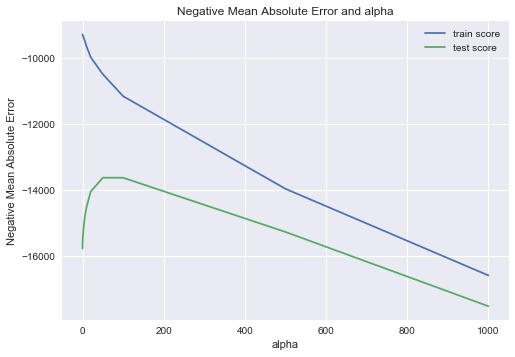

In [53]:
# plotting mean test and train scores with alpha 
cv_results['param_alpha'] = cv_results['param_alpha'].astype('float32')

# plotting
plt.plot(cv_results['param_alpha'], cv_results['mean_train_score']) # Plotting Mean train score
plt.plot(cv_results['param_alpha'], cv_results['mean_test_score']) # Plotting Mean test score

plt.xlabel('alpha')
plt.ylabel('Negative Mean Absolute Error')

plt.title("Negative Mean Absolute Error and alpha")
plt.legend(['train score', 'test score'], loc='upper right')

plt.show()

In [54]:
# Get the best alpha value and it's respective R2 score
print('Best value is: %s' % lasso_cv.best_params_)
print('r2 Score when %s: is %s \n' % (lasso_cv.best_params_, r2_score(y_test,lasso_cv.predict(X_test))))

Best value is: {'alpha': 50}
r2 Score when {'alpha': 50}: is 0.914318455943 



### Lasso Regression using Optimal alpha value

In [55]:
# Lasso regression for optimal alpha obtained from Lasso Regression on various alpha's
lasso = Lasso(alpha=50)

# Fitting on train data
lasso.fit(X_train, y_train) 

Lasso(alpha=50, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False)

In [56]:
# Coefficients after performing Lasso regression
lasso.coef_

array([  1.43970244e+03,   4.36981261e+03,   3.44070987e+02,
         1.57979385e+02,   9.60144056e+02,   5.35211498e+03,
         1.70875054e+03,  -0.00000000e+00,   7.14424319e+03,
         6.29880182e+03,   0.00000000e+00,   1.64785090e+03,
        -1.24246413e+03,   2.02496795e+04,   6.87889898e+02,
         0.00000000e+00,   1.47285470e+03,  -4.12766377e+01,
        -2.39267857e+03,  -1.67788855e+04,   2.66242634e+02,
         6.07188727e+02,   4.61644670e+01,   4.03234075e+03,
         1.31989835e+03,   2.42972855e+03,   1.84032605e+03,
         5.66550418e+02,   1.20482947e+03,   1.60957933e+03,
         9.63330027e+02,   3.77595728e+02,  -7.73457856e+01,
        -2.76474034e+02,   3.21967108e+03,   0.00000000e+00,
         0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
        -1.21529973e+03,  -4.93521369e+03,  -0.00000000e+00,
         1.10003977e+04,   0.00000000e+00,   6.06077612e+03,
         0.00000000e+00,  -0.00000000e+00,   0.00000000e+00,
         1.78502281e+03,

In [57]:
# Features and thier respective coefficients
lasso_coeffs_df = pd.DataFrame(list(zip(X.columns, lasso.coef_)), columns = ['Features', 'Coefficients'])
lasso_coeffs_df.sort_values(by='Coefficients', ascending=False).head(10)

,Features,Coefficients
114,HouseStyle_SFoyer,48098.672319
65,LandSlope_Sev,24147.010468
115,HouseStyle_SLvl,21962.497116
13,GrLivArea,20249.679490
113,HouseStyle_2Story,19919.659301
249,GarageCond_Po,16461.112914
80,Neighborhood_NoRidge,16430.158251
122,OverallQual_9,15589.664960
211,Heating_Grav,14591.387864
177,ExterCond_Fa,14313.315217


In [58]:
# Positive coefficients obtained from Lasso Regression
lasso_pos_coeffs_df = lasso_coeffs_df[(lasso_coeffs_df['Coefficients'])>0].sort_values(by='Coefficients', ascending=False)
lasso_pos_coeffs_df.head(10)

,Features,Coefficients
114,HouseStyle_SFoyer,48098.672319
65,LandSlope_Sev,24147.010468
115,HouseStyle_SLvl,21962.497116
13,GrLivArea,20249.679490
113,HouseStyle_2Story,19919.659301
249,GarageCond_Po,16461.112914
80,Neighborhood_NoRidge,16430.158251
122,OverallQual_9,15589.664960
211,Heating_Grav,14591.387864
177,ExterCond_Fa,14313.315217


In [59]:
# Negative coefficients obtained from Lasso Regression
lasso_neg_coeffs_df = lasso_coeffs_df[(lasso_coeffs_df['Coefficients'])<0].sort_values(by='Coefficients', ascending=False)
lasso_neg_coeffs_df.head(10)

,Features,Coefficients
17,HalfBath,-41.276638
180,Foundation_CBlock,-71.795098
32,MoSold,-77.345786
189,BsmtCond_Gd,-145.297799
50,MSZoning_RL,-206.230693
146,Exterior1st_CemntBd,-244.902281
33,YrSold,-276.474034
223,KitchenQual_Gd,-285.933150
214,HeatingQC_Fa,-358.943983
222,KitchenQual_Fa,-492.361169


In [60]:
# Non-zero coefficients obtained from Lasso Regression
lasso_df_nonzero = lasso_coeffs_df[(lasso_coeffs_df['Coefficients'])!=0].sort_values(by='Coefficients', ascending=False)

### Predictions using Lasso Regression

In [61]:
# Prediction on train dataset for Lasso
y_train_pred = lasso.predict(X_train)

# Prediction on test dataset for Lasso
y_test_pred = lasso.predict(X_test)

#### RMSE value for train and test data

In [62]:
from math import sqrt

# RMSE on train data
print('RMSE(Root Mean Squared Error) train data :', np.sqrt(metrics.mean_squared_error(y_train, y_train_pred)))
print("\n")

# RMSE on test data
print('RMSE(Root Mean Squared Error) test data :', np.sqrt(metrics.mean_squared_error(y_test, y_test_pred)))

RMSE(Root Mean Squared Error) train data : 15329.1960395


RMSE(Root Mean Squared Error) test data : 20315.968773


#### R2_score for train and test data

In [63]:
# on train data
print("R2 on train data",r2_score(y_train, y_train_pred))
print("\n")

# on test data
print("R2 on test data",r2_score(y_test, y_test_pred))

R2 on train data 0.939081197902


R2 on test data 0.914318455943


#### AIC, BIC and Adjusted R_Square for test data
We can skip calculating this, but for comparing models from Lasso and Ridge regression its better to calculate.

In [64]:
n = len(X_test)

# Calculating residual
resid = y_test - y_test_pred
sse = sum(resid**2)

k = len(lasso_df_nonzero['Features'])

# Calculating AIC
AIC = 2*k + 2*np.log(sse/n)
print("AIC",AIC)
print("\n")

# Calculating BIC
BIC = n*np.log(sse/n) + k*np.log(n)
print("BIC",BIC)
print("\n")

# Calculating r2
TSS = sum((y_test - np.mean(y_test))**2)
r_square = 1-(float(sse))/TSS
print("r_square",r_square)
print("\n")

# Calculating adjusted r2
adjusted_r_square = 1 - (1-r_square)*(n-1)/(n-k-1)
print("adjusted_r_square",adjusted_r_square)

AIC 311.676649979


BIC 8124.21026479


r_square 0.914318455943


adjusted_r_square 0.86409134391


### Model Evaluation (Visualising predictions)

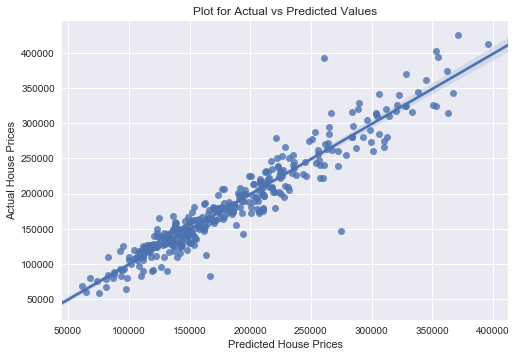

In [65]:
# Regression Plot
predict = sns.regplot(x=y_test_pred, y=y_test, fit_reg=True)
predict.set(xlabel='Predicted House Prices', ylabel='Actual House Prices')
plt.title('Plot for Actual vs Predicted Values')
plt.show()

### Residual Analysis

#### For train data

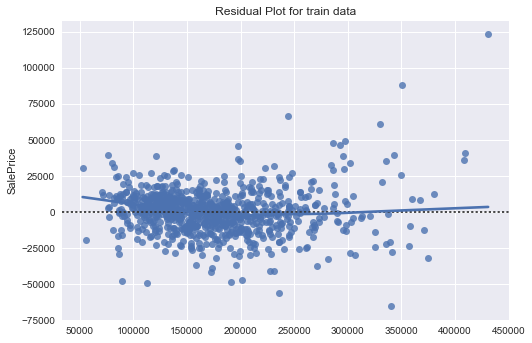

In [66]:
# Residual Plot on train data
sns.residplot(x=y_train_pred, y=y_train, lowess=True)
plt.title('Residual Plot for train data')
plt.show()

#### For test data

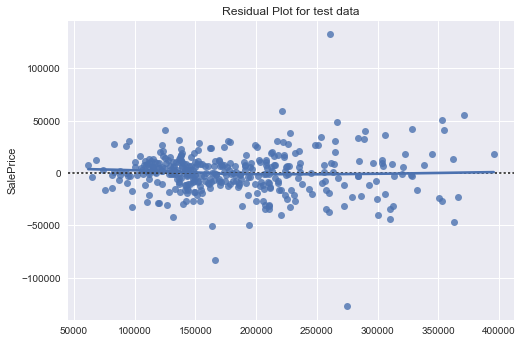

In [67]:
# Residual Plot on test data
sns.residplot(x=y_test_pred, y=y_test, lowess=True)
plt.title('Residual Plot for test data')
plt.show()

#### Plot for train and test data

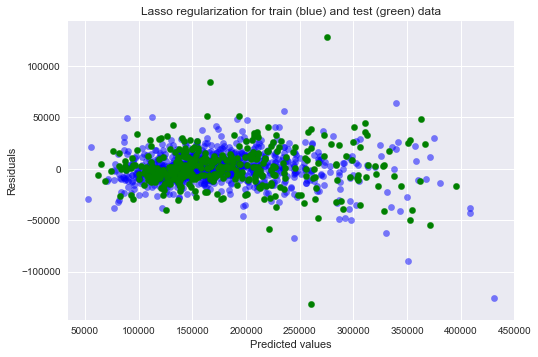

In [68]:
# Residual plot on train and test data combined
plt.scatter(y_train_pred, y_train_pred - y_train, c='b', s=40, alpha=0.5)
plt.scatter(y_test_pred, y_test_pred - y_test, c='g', s=40)

plt.title("Lasso regularization for train (blue) and test (green) data")
plt.xlabel("Predicted values")
plt.ylabel('Residuals')
plt.show()

### <span style="color:blue">Observations from Lasso Regression</span>

#### First observation is that __optimal alpha value for Lasso Regression - 50__

#### The top ten features having positive coefficients are as follows
- HouseStyle_SFoyer (Style of dwelling(House))
- LandSlope_Sev (Slope of property)
- HouseStyle_SLvl (Style of dwelling(House))
- GrLivArea (Above grade (ground) living area square feet)
- HouseStyle_2Story (Style of dwelling(House))
- GarageCond_Po (Garage condition)
- Neighborhood_NoRidge ( Physical locations within Ames city limits)
- OverallQual_9 (Rates the overall material and finish of the house)
- Heating_Grav (Type of heating)
- ExterCond_Fa (Evaluates the present condition of the material on the exterior)
These feature are positively corelated with Sale Price.

#### The top ten features having negative coefficients are as follows
- HalfBath (Half baths above grade)
- Foundation_CBlock (Type of foundation)
- MoSold (Month Sold (MM))
- BsmtCond_Gd (Evaluates the general condition of the basement)
- MSZoning_RL (Identifies the general zoning classification of the sale)
- Exterior1st_CemntBd (Exterior covering on house)
- YrSold (Year Sold (YYYY))
- KitchenQual_Gd (Kitchen quality)
- HeatingQC_Fa ( Heating quality and condition)
- KitchenQual_Fa (Kitchen quality)

These feature are negatively corelated with Sale Price.

## 8.2 Ridge Regression

In [69]:
# list of alphas to tune
params = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 4.0, 5.0, 
                    6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000 ]}

ridge = Ridge()

# cross validation
folds = 5 # selecting number of fold for cross validation

# Performing Grid Search Cross Validation using Ridge
ridge_cv = GridSearchCV(estimator = ridge, 
                              param_grid = params, 
                              scoring= 'neg_mean_absolute_error', 
                              cv = folds, return_train_score=True, verbose = 1)

# Fitting on train data
ridge_cv.fit(X_train, y_train) 

Fitting 5 folds for each of 28 candidates, totalling 140 fits


[Parallel(n_jobs=1)]: Done 140 out of 140 | elapsed:    3.0s finished


GridSearchCV(cv=5, error_score='raise',
       estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001),
       fit_params={}, iid=True, n_jobs=1,
       param_grid={'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score=True,
       scoring='neg_mean_absolute_error', verbose=1)

In [70]:
# Results of lasso regression for various alpha
cv_results = pd.DataFrame(ridge_cv.cv_results_)
cv_results = cv_results[cv_results['param_alpha']<=200]
cv_results.head()

,mean_fit_time,mean_score_time,mean_test_score,mean_train_score,param_alpha,params,rank_test_score,split0_test_score,split0_train_score,split1_test_score,...,split2_test_score,split2_train_score,split3_test_score,split3_train_score,split4_test_score,split4_train_score,std_fit_time,std_score_time,std_test_score,std_train_score
0,0.028110,0.000997,-15584.444218,-9283.035083,0.0001,{'alpha': 0.0001},25,-15626.901027,-9417.984026,-15674.954348,...,-16052.227646,-9443.623816,-15396.889820,-9238.664494,-15171.248249,-9141.722038,0.021934,1.081065e-06,294.863888,124.904760
1,0.016949,0.000804,-15574.286625,-9284.062107,0.001,{'alpha': 0.001},24,-15621.252297,-9418.593134,-15669.918390,...,-16034.743193,-9444.560711,-15378.110622,-9239.182378,-15167.408625,-9143.807101,0.001401,4.021101e-04,292.371747,124.596103
2,0.018947,0.000997,-15492.366509,-9294.208884,0.01,{'alpha': 0.01},23,-15572.818704,-9425.274385,-15622.159577,...,-15876.234760,-9454.633965,-15212.346261,-9246.210650,-15178.273242,-9161.336921,0.003513,9.246216e-07,263.719377,122.564294
3,0.016157,0.001000,-15258.486308,-9336.343099,0.05,{'alpha': 0.05},22,-15424.338281,-9463.860455,-15423.010680,...,-15431.250726,-9502.486013,-14783.219031,-9286.238590,-15230.612820,-9207.885843,0.000747,5.848598e-06,249.430794,123.388442
4,0.015361,0.000790,-15065.797190,-9387.028039,0.1,{'alpha': 0.1},21,-15303.653823,-9516.448929,-15196.829445,...,-15192.590151,-9554.607216,-14459.278637,-9344.695308,-15176.633893,-9240.469843,0.001845,3.953022e-04,306.584805,126.326164


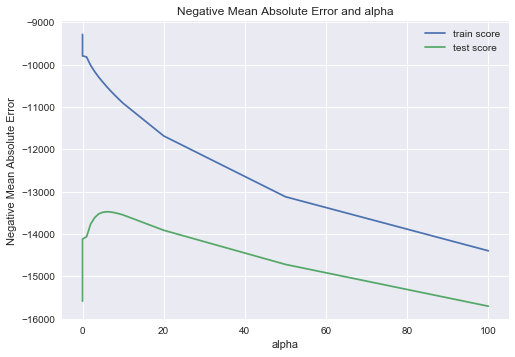

In [71]:
# plotting mean test and train scoes with alpha 
cv_results['param_alpha'] = cv_results['param_alpha'].astype('int32')

# plotting
plt.plot(cv_results['param_alpha'], cv_results['mean_train_score'])
plt.plot(cv_results['param_alpha'], cv_results['mean_test_score'])
plt.xlabel('alpha')
plt.ylabel('Negative Mean Absolute Error')
plt.title("Negative Mean Absolute Error and alpha")
plt.legend(['train score', 'test score'], loc='upper right')
plt.show()

In [72]:
# Get the best alpha value and it's respective R2 score
print('Best value is: %s' % ridge_cv.best_params_)
print('r2 Score when %s: is %s \n' % (ridge_cv.best_params_, r2_score(y_test,ridge_cv.predict(X_test))))

Best value is: {'alpha': 6.0}
r2 Score when {'alpha': 6.0}: is 0.914684101613 



#### Ridge Regression using Optimal alpha value

In [73]:
# Ridge regression for optimal alpha obtained from Ridge Regression on various alpha's
ridge = Ridge(alpha=6)

# Fitting on train data
ridge.fit(X_train, y_train)

Ridge(alpha=6, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001)

In [74]:
# Coefficients after performing Ridge regression
ridge.coef_

array([  1.78686793e+03,   4.45766133e+03,   3.38797560e+02,
         2.05185174e+02,   1.42396204e+03,   6.05680246e+03,
         2.00157286e+03,   4.26847819e+02,   8.05360357e+03,
         6.32357875e+03,   5.30134714e+03,   8.43579201e+03,
        -1.15400075e+03,   1.23421274e+04,   6.04098296e+02,
         4.33950801e+02,   1.36011057e+03,  -1.19019791e+02,
        -2.90577360e+03,  -1.26985108e+04,   7.59407310e+02,
         1.41735463e+03,   3.27289452e+01,   4.58249450e+03,
         1.21213555e+03,   2.53666776e+03,   1.86619504e+03,
         6.08107670e+02,   1.23542823e+03,   1.48083613e+03,
         1.04072923e+03,   6.52050558e+02,   1.41987542e+01,
        -3.66078285e+02,   5.86644778e+03,   4.64682858e+03,
         2.70034165e+03,   1.37574687e+03,   5.33892619e+03,
        -4.05675695e+03,  -6.32894358e+03,  -7.39921661e+02,
         1.07812852e+04,   2.91428833e+03,   7.34611245e+03,
         2.41201313e+03,  -8.52379153e+02,   6.90209168e+02,
         1.68972141e+03,

In [75]:
# Features and their respective coefficients
ridge_coeffs_df = pd.DataFrame(list(zip(X.columns, ridge.coef_)), columns = ['Features', 'Coefficients'])
ridge_coeffs_df.sort_values(by='Coefficients', ascending=False).head(10)

,Features,Coefficients
114,HouseStyle_SFoyer,27850.849966
65,LandSlope_Sev,18239.365390
80,Neighborhood_NoRidge,15325.483036
211,Heating_Grav,14514.606968
249,GarageCond_Po,13465.980830
113,HouseStyle_2Story,12785.362695
177,ExterCond_Fa,12562.002521
13,GrLivArea,12342.127392
136,RoofMatl_CompShg,12154.485590
122,OverallQual_9,11315.599126


In [76]:
# Positive coefficients obtained from Ridge Regression
ridge_pos_coeffs_df = ridge_coeffs_df[(ridge_coeffs_df['Coefficients'])>0].sort_values(by='Coefficients', ascending=False)
ridge_pos_coeffs_df.head(10)

,Features,Coefficients
114,HouseStyle_SFoyer,27850.849966
65,LandSlope_Sev,18239.365390
80,Neighborhood_NoRidge,15325.483036
211,Heating_Grav,14514.606968
249,GarageCond_Po,13465.980830
113,HouseStyle_2Story,12785.362695
177,ExterCond_Fa,12562.002521
13,GrLivArea,12342.127392
136,RoofMatl_CompShg,12154.485590
122,OverallQual_9,11315.599126


In [77]:
# Negative coefficients obtained from Ridge Regression
ridge_neg_coeffs_df = ridge_coeffs_df[(ridge_coeffs_df['Coefficients'])<0].sort_values(by='Coefficients', ascending=False)
ridge_neg_coeffs_df.head(10)

,Features,Coefficients
98,Condition2_Feedr,-42.259230
154,Exterior1st_Wd Sdng,-57.499631
57,LandContour_HLS,-78.878543
167,Exterior2nd_Stucco,-112.549595
17,HalfBath,-119.019791
236,GarageType_Attchd,-191.420964
90,Condition1_Feedr,-205.724502
202,BsmtFinType1_Unf,-209.735477
152,Exterior1st_Stucco,-214.855764
201,BsmtFinType1_Rec,-230.843426


In [78]:
# Negative coefficients obtained from Ridge Regression
ridge_df_nonzero = ridge_coeffs_df[(ridge_coeffs_df['Coefficients'])!=0].sort_values(by='Coefficients', ascending=False)
ridge_df_nonzero.head(10)

,Features,Coefficients
114,HouseStyle_SFoyer,27850.849966
65,LandSlope_Sev,18239.365390
80,Neighborhood_NoRidge,15325.483036
211,Heating_Grav,14514.606968
249,GarageCond_Po,13465.980830
113,HouseStyle_2Story,12785.362695
177,ExterCond_Fa,12562.002521
13,GrLivArea,12342.127392
136,RoofMatl_CompShg,12154.485590
122,OverallQual_9,11315.599126


### Predictions using Ridge Regression

In [79]:
# Prediction on train dataset for Ridge
y_train_pred1 = ridge_cv.predict(X_train)

# Prediction on test dataset for Ridge
y_test_pred1 = ridge_cv.predict(X_test)

#### RMSE value for train and test data

In [80]:
from math import sqrt

# RMSE on train data
print('RMSE(Root Mean Squared Error) train data :', np.sqrt(metrics.mean_squared_error(y_train, y_train_pred1)))
print("\n")

# RMSE on test data
print('RMSE(Root Mean Squared Error) test data :', np.sqrt(metrics.mean_squared_error(y_test, y_test_pred1)))

RMSE(Root Mean Squared Error) train data : 15298.2620588


RMSE(Root Mean Squared Error) test data : 20272.5732654


#### R2_score for train and test data

In [81]:
# on train data
print("R2 on train data",r2_score(y_train, y_train_pred1))
print("\n")

# on test data
print("R2 on test data",r2_score(y_test, y_test_pred1))

R2 on train data 0.939326815434


R2 on test data 0.914684101613


#### AIC, BIC and Adjusted R_Square for test data
We can skip calculating this, but for comparing models from Lasso and Ridge regression its better to calculate.

In [82]:
n = len(X_test)

# Calculating residual
resid = y_test - y_test_pred1
sse = sum(resid**2)

k = len(ridge_df_nonzero['Features'])

# Calculating AIC
AIC = 2*k + 2*np.log(sse/n)
print("AIC",AIC)
print("\n")

# Calculating BIC
BIC = n*np.log(sse/n) + k*np.log(n)
print("BIC",BIC)
print("\n")

# Calculating r2
TSS = sum((y_test - np.mean(y_test))**2)
r_square = 1-(float(sse))/TSS
print("r_square",r_square)
print("\n")

# Calculating adjusted r2
adjusted_r_square = 1 - (1-r_square)*(n-1)/(n-k-1)
print("adjusted_r_square",adjusted_r_square)

AIC 531.668096723


BIC 8772.81981989


r_square 0.914684101613


adjusted_r_square 0.742653683555


### Model Evaluation (Visualising predictions)

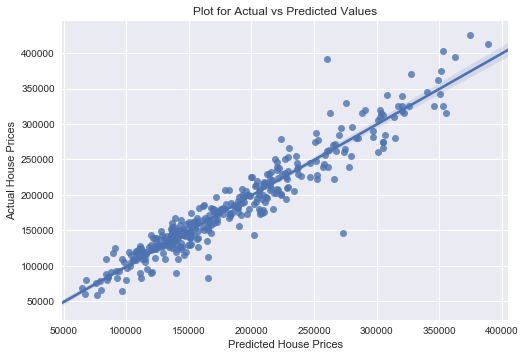

In [83]:
# Regression Plot
predict1 = sns.regplot(x=y_test_pred1, y=y_test, fit_reg=True)
predict1.set(xlabel='Predicted House Prices', ylabel='Actual House Prices')
plt.title('Plot for Actual vs Predicted Values')
plt.show()

### Residual Plots

#### For train data

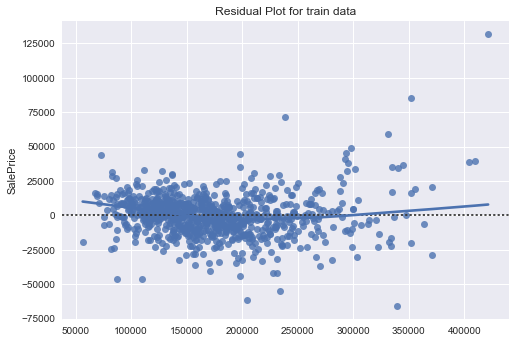

In [84]:
# Residual Plot on train data
sns.residplot(x=y_train_pred1, y=y_train, lowess=True)
plt.title('Residual Plot for train data')
plt.show()

#### For test data

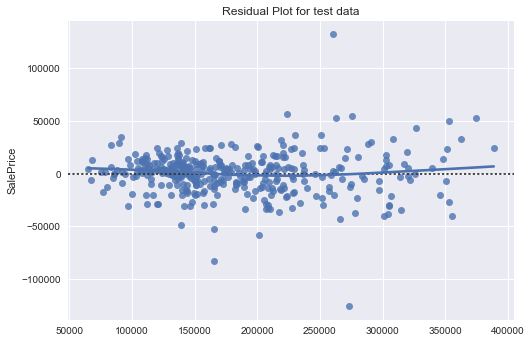

In [85]:
# Residual Plot on test data
sns.residplot(x=y_test_pred1, y=y_test, lowess=True)
plt.title('Residual Plot for test data')
plt.show()

#### Combined

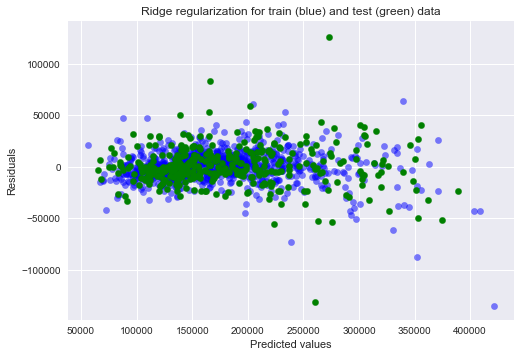

In [86]:
# Residual plot on train and test data combined
plt.scatter(y_train_pred1, y_train_pred1 - y_train, c='b', s=40, alpha=0.5)
plt.scatter(y_test_pred1, y_test_pred1 - y_test, c='g', s=40)

plt.title("Ridge regularization for train (blue) and test (green) data")
plt.xlabel("Predicted values")
plt.ylabel('Residuals')
plt.show()

### <span style="color:blue">Observations from Ridge Regression</span>

#### First observation is that __optimal alpha value for Ridge Regression - 6__

#### The top ten features having positive coefficients are as follows
- HouseStyle_SFoyer (Style of dwelling(House))
- LandSlope_Sev (Slope of property)
- Neighborhood_NoRidge ( Physical locations within Ames city limits)
- Heating_Grav (Type of heating)
- GarageCond_Po (Garage condition)
- HouseStyle_2Story (Style of dwelling(House))
- ExterCond_Fa (Evaluates the present condition of the material on the exterior)
- GrLivArea (Above grade (ground) living area square feet)
- RoofMatl_CompShg (Roof material)
- OverallQual_9 (Rates the overall material and finish of the house)

These feature are positively corelated with Sale Price.

#### The top ten features having negative coefficients are as follows
- Condition2_Feedr ( Proximity to various conditions (if more than one is present))
- Exterior1st_Wd Sdng (Exterior covering on house)
- LandContour_HLS (Flatness of the property)
- Exterior2nd_Stucco (Exterior covering on house (if more than one material))
- HalfBath (Half baths above grade)
- GarageType_Attchd (Garage location)
- Condition1_Feedr (Proximity to various conditions)
- BsmtFinType1_Unf (Rating of basement finished area)
- Exterior1st_Stucco (Exterior covering on house)
- BsmtFinType1_Rec (Rating of basement finished area)

These feature are negatively corelated with Sale Price.

# 9. Comparing results from Lasso and Ridge regression

- <span style="color:blue">__Ridge Regression__</span>
    - Best (optimal) Alpha - 6
    - R2_train - 0.939	  
    - R2_test - 0.914
    - AIC - 531.66	    
    - BIC - 8772.81	       
    - Adjusted_R2_test0.742
    
- <span style="color:blue">__Lasso Regression__</span>
    - Best (optimal) Alpha - 50
    - R2_train - 0.939	  
    - R2_test - 0.914
    - AIC - 311.67    
    - BIC - 8124.21       
    - Adjusted_R2_test - 0.864</span>
    	           	  	     	    	       

#### Observation from above metrics
- __Optimal value of lambda(alpha)__
    - For Ridge regression is – 6
    - For Lasso regression is – 50


- __For Ridge and Lasso regression R2_train and R2_test is same__
    - For Ridge regression R2_train – 0.939 and R2_test – 0.914 
    - For Lasso regression R2_train – 0.939 and R2_test – 0.914


- __For Ridge Regression__
    - AIC - 531.66
    - BIC - 8772.81
    - Adjusted_R2 - 0.742
- __For Lasso Regression__
    - AIC - 311.67
    - BIC - 8124.21
    - Adjusted_R2 - 0.864

We know that more the value of lambda(alpha) better is the model.<br>
From the above matrics we can conclude that <span style="color:blue">__Lasso Regression with alpha = 50__</span> __is better than__  <span style="color:blue">__Ridge Regression__</span>

# 10. Conclusion

### From Ridge and Lasoo regression we conclude that
- Both RMSE and R2_score of train and test data produced by Ridge Regression and Lasso Regression are same.
- Optimal value of alpha(lambda)
  - For Ridge regression - 6
  - For Lasso regression - 50
- By observing scores and residual plots we can conclude that __model built using Lasso Regression is better model for the data.__

### Features that are positively and negatively correlated with the Sale Price using Lasso Regression are:

<span style="color:blue">__The top ten important features that are positively correlated with Sale Price are:__</span>

- HouseStyle_SFoyer (Style of dwelling(House))
- LandSlope_Sev (Slope of property)
- HouseStyle_SLvl (Style of dwelling(House))
- GrLivArea (Above grade (ground) living area square feet)
- HouseStyle_2Story (Style of dwelling(House))
- GarageCond_Po (Garage condition)
- Neighborhood_NoRidge ( Physical locations within Ames city limits)
- OverallQual_9 (Rates the overall material and finish of the house)
- Heating_Grav (Type of heating)
- ExterCond_Fa (Evaluates the present condition of the material on the exterior)

<span style="color:green">__The Sale Price of a house is more when the above features are present.__</span>

<br>
<span style="color:blue">__The top ten important features that are negatively correlated with the Sale Price are:__</span>

- HalfBath (Half baths above grade)
- Foundation_CBlock (Type of foundation)
- MoSold (Month Sold (MM))
- BsmtCond_Gd (Evaluates the general condition of the basement)
- MSZoning_RL (Identifies the general zoning classification of the sale)
- Exterior1st_CemntBd (Exterior covering on house)
- YrSold (Year Sold (YYYY))
- KitchenQual_Gd (Kitchen quality)
- HeatingQC_Fa ( Heating quality and condition)
- KitchenQual_Fa (Kitchen quality)

<span style="color:green">__The Sale Price of a house the has negative impact means it is less when the above features are present.__</span>